### Problem Statement:
This dataset includes details of applicants who have applied for loan. The dataset includes details like credit history, loan amount, their income, dependents etc. 
### Implementations:
Need to build a model that can predict whether the loan of the applicant will be approved or not on the basis of the details provided in the dataset. 

In [1]:
import pandas as pd
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, roc_curve, precision_recall_curve,roc_auc_score, f1_score, confusion_matrix


Import Most basic Library

In [2]:
df_loan=pd.read_csv('https://raw.githubusercontent.com/dsrscientist/DSData/master/loan_prediction.csv')
df_loan.head(5)

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y


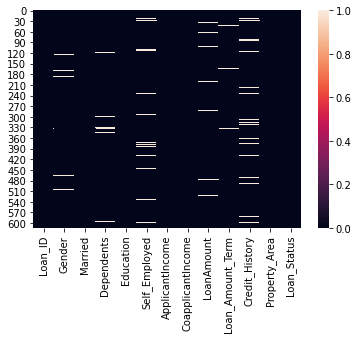

In [3]:
sns.heatmap(df_loan.isnull())

Graphysical representations of Null value present in dataset.

In [4]:

#Lets chcek the null values 
for col in df_loan.columns:
    print("Column data type :",df_loan[col].dtype," column name :",col," Null values: ",df_loan[col].isnull().sum())

Column data type : object  column name : Loan_ID  Null values:  0
Column data type : object  column name : Gender  Null values:  13
Column data type : object  column name : Married  Null values:  3
Column data type : object  column name : Dependents  Null values:  15
Column data type : object  column name : Education  Null values:  0
Column data type : object  column name : Self_Employed  Null values:  32
Column data type : int64  column name : ApplicantIncome  Null values:  0
Column data type : float64  column name : CoapplicantIncome  Null values:  0
Column data type : float64  column name : LoanAmount  Null values:  22
Column data type : float64  column name : Loan_Amount_Term  Null values:  14
Column data type : float64  column name : Credit_History  Null values:  50
Column data type : object  column name : Property_Area  Null values:  0
Column data type : object  column name : Loan_Status  Null values:  0


Aboveb o/p shows presense of null values in each column

In [5]:
df_loan['Gender']=df_loan['Gender'].fillna(df_loan['Gender'].mode()[0])
df_loan['Married']=df_loan['Married'].fillna(df_loan['Married'].mode()[0])
df_loan['Dependents']=df_loan['Dependents'].fillna(df_loan['Dependents'].mode()[0])
df_loan['Self_Employed']=df_loan['Self_Employed'].fillna(df_loan['Self_Employed'].mode()[0])

Fill the null value as categorical value by Mode.

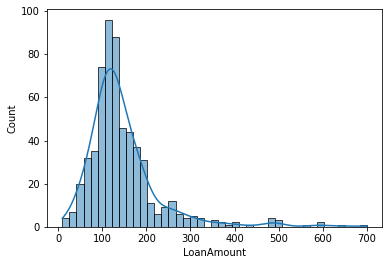

In [6]:
sns.histplot(df_loan.LoanAmount,kde=True)

As LoanAmount column is not normally distrubuted.

In [7]:
df_loan['LoanAmount']=df_loan['LoanAmount'].fillna(df_loan['LoanAmount'].median())

As this column is not normally distrubuted hence null values are replaced by median.

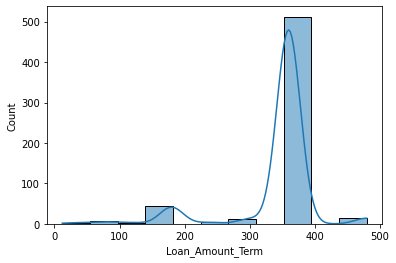

In [8]:
sns.histplot(df_loan.Loan_Amount_Term,kde=True)

As Loan_Amount_Term column is not normally distrubuted.

In [9]:
df_loan['Loan_Amount_Term']=df_loan['Loan_Amount_Term'].fillna(df_loan['Loan_Amount_Term'].median())


As this column is not normally distrubuted hence null values are replaced by median.

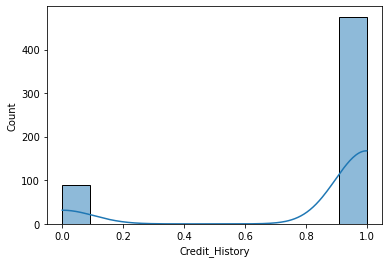

In [10]:
sns.histplot(df_loan.Credit_History,kde=True)

As Credit_History column is not normally distrubuted.

In [11]:
df_loan['Credit_History']=df_loan['Credit_History'].fillna(df_loan['Credit_History'].median())


As this column is not normally distrubuted hence null values are replaced by median.

In [12]:
#Lets describe the dataset
df_loan.describe()

,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History
count,614.000000,614.000000,614.000000,614.000000,614.000000
mean,5403.459283,1621.245798,145.752443,342.410423,0.855049
std,6109.041673,2926.248369,84.107233,64.428629,0.352339
min,150.000000,0.000000,9.000000,12.000000,0.000000
25%,2877.500000,0.000000,100.250000,360.000000,1.000000
50%,3812.500000,1188.500000,128.000000,360.000000,1.000000
75%,5795.000000,2297.250000,164.750000,360.000000,1.000000
max,81000.000000,41667.000000,700.000000,480.000000,1.000000


there is difference between mean value and median so there can outliers present in the data set

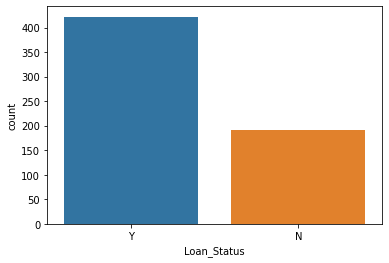

In [13]:
sns.countplot(x="Loan_Status",data=df_loan)


imbalanced dataset problem so we can use SMOTE just to increase instances of minority classes in training dataset

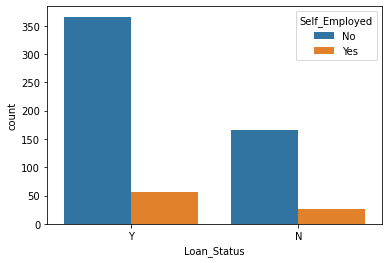

In [14]:
#lets check the count of loan status considering "Self_Employed"
sns.countplot(x="Loan_Status",hue="Self_Employed",data=df_loan)

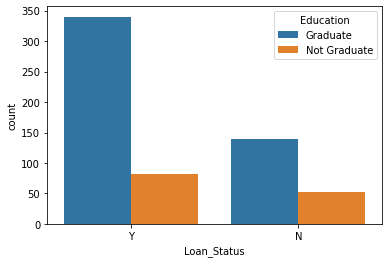

In [15]:
#Lets check the count based on "Education"
sns.countplot(x="Loan_Status",hue="Education",data=df_loan)

people who are graduated has tendency of getting loans than who are not

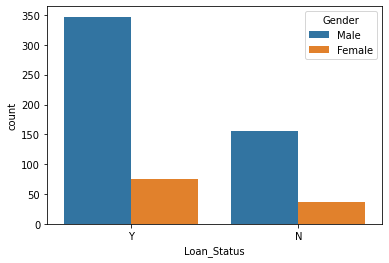

In [16]:
#lets chcek loan status based on gender
sns.countplot(x="Loan_Status",hue="Gender",data=df_loan)

there are more number of males applying fro the loans comapred to female

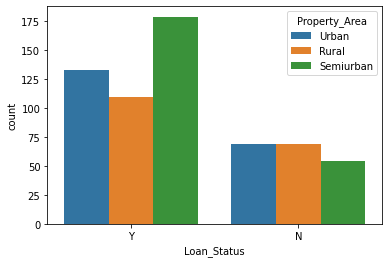

In [17]:
#lets chcek the loan status based on property area
sns.countplot(x="Loan_Status",hue="Property_Area",data=df_loan)

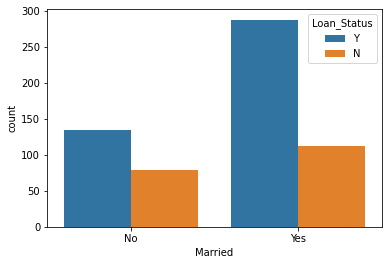

In [18]:
#Lets chcek the count based on marital status
sns.countplot(x="Married",hue="Loan_Status",data=df_loan)

ration of people geting loans to not getting loans when they are married is high

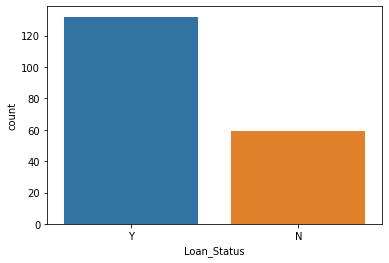

In [19]:
#Lets chcek loan status for applicant income greater than 5000
sns.countplot(x="Loan_Status",data=df_loan.loc[df_loan["ApplicantIncome"]>5000])

people whose loan was sanctioned are more than double of prople whose loan was not sanctioned

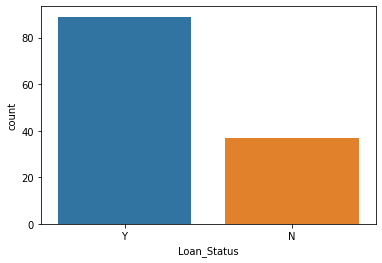

In [20]:
#Lets chcek what is the effect on above count if co-aplicant income is 0
sns.countplot(x="Loan_Status",data=df_loan.loc[(df_loan["ApplicantIncome"]>5000)&(df_loan["CoapplicantIncome"]==0)])

count reduced but still ratio is almost same

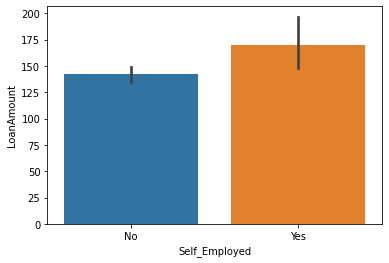

In [21]:
#lets compare the average loan amount between self employed and not self employed
sns.barplot(y="LoanAmount",x="Self_Employed",data=df_loan)

Avaerge loan amount demanded by the self employed is more but there is not too much difference

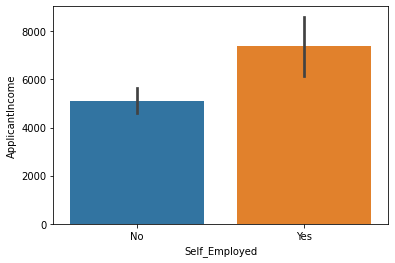

In [22]:
#Lets compare the average income of employed and self employed
sns.barplot(y="ApplicantIncome",x="Self_Employed",data=df_loan)

Average income is also

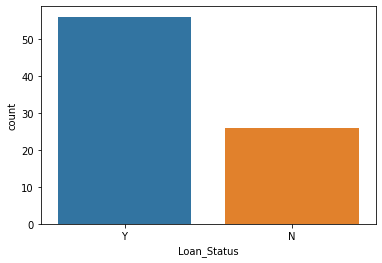

In [23]:
#Lets compare the count of people who got loans and who didn't
sns.countplot(x="Loan_Status",data=df_loan.loc[df_loan["Self_Employed"]=="Yes"])

there are more than double who got loan

next step is to compare the average income of people who got loan and who didn't ,given they are self employed

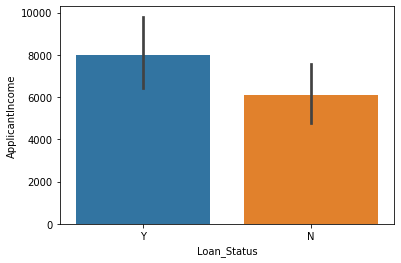

In [24]:
sns.barplot(y="ApplicantIncome",x="Loan_Status",data=df_loan.loc[df_loan["Self_Employed"]=="Yes"])

So people who got loan has averge income more and it is expected

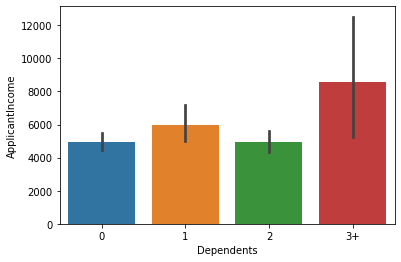

In [25]:

# let's chcek the average loan amount as per Dependents
sns.barplot(y="ApplicantIncome",x="Dependents",data=df_loan)

Average income of dependents of with 2 is less than with 1

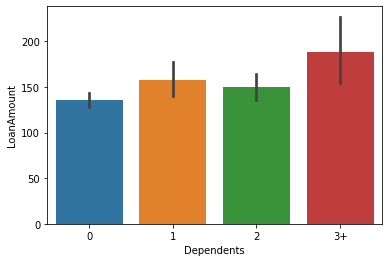

In [26]:
#lets chcek the average loan amount requested
sns.barplot(y="LoanAmount",x="Dependents",data=df_loan)

Averge loan amount by person with dependents more 3 is highest

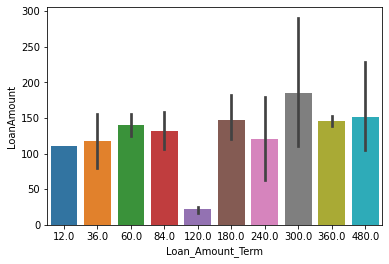

In [27]:
#Average loan amount requested groupped by Loan_Amount_Term
sns.barplot(x="Loan_Amount_Term",y="LoanAmount",data=df_loan)

In [28]:
pip install dataprep

     |████████████████████████████████| 1.8MB 2.3MB/s 
     |████████████████████████████████| 727kB 31.0MB/s 
     |████████████████████████████████| 81kB 9.6MB/s 
     |████████████████████████████████| 71kB 9.0MB/s 
     |████████████████████████████████| 849kB 40.8MB/s 
     |████████████████████████████████| 368kB 29.5MB/s 
     |████████████████████████████████| 1.5MB 36.6MB/s 
     |████████████████████████████████| 10.1MB 44.7MB/s 
     |████████████████████████████████| 51kB 7.7MB/s 
     |████████████████████████████████| 1.3MB 35.9MB/s 
     |████████████████████████████████| 747kB 38.1MB/s 
     |████████████████████████████████| 122kB 32.8MB/s 
     |████████████████████████████████| 51kB 6.3MB/s 
     |████████████████████████████████| 296kB 44.7MB/s 
     |████████████████████████████████| 143kB 46.5MB/s 
  Created wheel for metaphone: filename=Metaphone-0.6-cp37-none-any.whl size=13918 sha256=16aa46382aefe53ea945b1f3d4c6f5b35c04a15da897d15772cfe4110fdeedac
  Stored in d

DataPrep Report
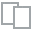
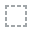
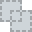
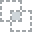
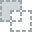
...
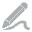
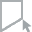
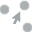
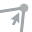
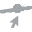

In [29]:
from dataprep.eda import create_report
create_report(df_loan)

Using DataPrep Displayed all EDA of dataset in one place.

In [30]:
print(df_loan.skew())
print("Total count of numeric features: ",len(df_loan.skew()))
print("count of features which are significantly skewed: ",len(df_loan.skew().loc[abs(df_loan.skew())>0.5]))

ApplicantIncome      6.539513
CoapplicantIncome    7.491531
LoanAmount           2.743053
Loan_Amount_Term    -2.402112
Credit_History      -2.021971
dtype: float64
Total count of numeric features:  5
count of features which are significantly skewed:  5


Before consider skewed data no one column are normally distrubutted.

In [31]:
import numpy as np
for index in df_loan.skew().index:
    if df_loan.skew().loc[index]>0.5:
        df_loan[index]=np.log1p(df_loan[index])
    if df_loan.skew().loc[index]<-0.5:
        df_loan[index]=np.square(df_loan[index])
print(df_loan.skew())
print("Total count of numeric features: ",len(df_loan.skew()))
print("count of features which are significantly skewed: ",len(df_loan.skew().loc[abs(df_loan.skew())>0.5]))

ApplicantIncome      0.482128
CoapplicantIncome   -0.173073
LoanAmount          -0.151578
Loan_Amount_Term    -1.183420
Credit_History      -2.021971
dtype: float64
Total count of numeric features:  5
count of features which are significantly skewed:  2


After consider skewed data remaning two columns found not normally distrubuted.

In [32]:
#we can delete loan id as it has no significance in prediction
df_loan.drop(columns=["Loan_ID"],inplace=True)

In [33]:
df_loan.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Gender             614 non-null    object 
 1   Married            614 non-null    object 
 2   Dependents         614 non-null    object 
 3   Education          614 non-null    object 
 4   Self_Employed      614 non-null    object 
 5   ApplicantIncome    614 non-null    float64
 6   CoapplicantIncome  614 non-null    float64
 7   LoanAmount         614 non-null    float64
 8   Loan_Amount_Term   614 non-null    float64
 9   Credit_History     614 non-null    float64
 10  Property_Area      614 non-null    object 
 11  Loan_Status        614 non-null    object 
dtypes: float64(5), object(7)
memory usage: 57.7+ KB


As displayed details informations of dataset found dtypes: float64(5), object(7)

In [34]:
from sklearn.preprocessing import LabelEncoder
le= LabelEncoder()
for i in range(0,df_loan.shape[1]):
    if df_loan.dtypes[i]=='object':
        df_loan[df_loan.columns[i]] = le.fit_transform(df_loan[df_loan.columns[i]])

Using LabelEncoding converted numerical form of columns.

In [35]:
df_loan

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,1,0,0,0,0,8.674197,0.000000,4.859812,129600.0,1.0,2,1
1,1,1,1,0,0,8.430327,7.319202,4.859812,129600.0,1.0,0,0
2,1,1,0,0,1,8.006701,0.000000,4.204693,129600.0,1.0,2,1
3,1,1,0,1,0,7.857094,7.765993,4.795791,129600.0,1.0,2,1
4,1,0,0,0,0,8.699681,0.000000,4.955827,129600.0,1.0,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...
609,0,0,0,0,0,7.972811,0.000000,4.276666,129600.0,1.0,0,1
610,1,1,3,0,0,8.320448,0.000000,3.713572,32400.0,1.0,0,1
611,1,1,1,0,0,8.996280,5.484797,5.537334,129600.0,1.0,2,1
612,1,1,2,0,0,8.933796,0.000000,5.236442,129600.0,1.0,2,1


Now Data is ready to train Model.

In [36]:
from scipy.stats import zscore
z_score=abs(zscore(df_loan))
print(df_loan.shape)
df_loan_final=df_loan.loc[(z_score<3).all(axis=1)]
print(df_loan_final.shape)

(614, 12)
(573, 12)


As per aboveb to consider outliers less than 10% data we lossed.

In [37]:
#dividing it into input and output
df_x=df_loan_final.drop(columns=["Loan_Status"])
y=df_loan_final[["Loan_Status"]]

Seprated dependent and independent Variable.

In [38]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
sc.fit(df_x)
x=sc.transform(df_x)
x=pd.DataFrame(x,columns=df_x.columns)

As scalled all columns in same scale.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """


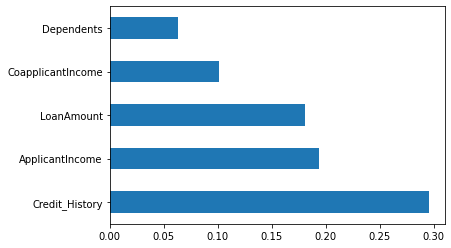

In [39]:
#plot graph of feature importances for better visualization
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
model = ExtraTreesClassifier()
model.fit(x,y)
feat_importances = pd.Series(model.feature_importances_, index=x.columns)
feat_importances.nlargest(5).plot(kind='barh')
plt.show()

In [40]:
from imblearn.over_sampling import SMOTE
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
def max_aucroc_score(clf,df_x,y):
    max_aucroc_score=0
    for r_state in range(42,100):
        x_train, x_test, y_train, y_test = train_test_split(df_x, y,random_state = r_state,test_size=0.20,stratify=y)
        x_train, y_train = SMOTE().fit_sample(x_train, y_train)
        clf.fit(x_train,y_train)
        y_pred = clf.predict(x_test)
        aucroc_scr=roc_auc_score(y_test,y_pred)
        print("auc roc score corresponding to ",r_state," is ",aucroc_scr)
        if aucroc_scr>max_aucroc_score:
            max_aucroc_score=aucroc_scr
            final_r_state=r_state
    print("max auc roc score corresponding to ",final_r_state," is ",max_aucroc_score)
    return final_r_state

/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


Create Funtions fo find max auc roc score corresponding to Randomstate.

In [41]:
from sklearn.linear_model import LogisticRegression
import warnings
warnings.filterwarnings("ignore")
lg_clf=LogisticRegression()
max_aucroc_score(lg_clf,x,y)

auc roc score corresponding to  42  is  0.7080357142857143
auc roc score corresponding to  43  is  0.7116071428571429
auc roc score corresponding to  44  is  0.6723214285714285
auc roc score corresponding to  45  is  0.6366071428571429
auc roc score corresponding to  46  is  0.625
auc roc score corresponding to  47  is  0.7419642857142856
auc roc score corresponding to  48  is  0.6821428571428572
auc roc score corresponding to  49  is  0.7464285714285714
auc roc score corresponding to  50  is  0.6866071428571429
auc roc score corresponding to  51  is  0.6491071428571429
auc roc score corresponding to  52  is  0.6375
auc roc score corresponding to  53  is  0.65625
auc roc score corresponding to  54  is  0.65
auc roc score corresponding to  55  is  0.7749999999999999
auc roc score corresponding to  56  is  0.73125
auc roc score corresponding to  57  is  0.6535714285714286
auc roc score corresponding to  58  is  0.5973214285714286
auc roc score corresponding to  59  is  0.732142857142857


55

Using LogisticRegression find ROC AUC 82% crosponding to random state=84

In [42]:
from sklearn.model_selection import cross_val_score
print("Mean roc auc score for logistic classifier: ",cross_val_score(lg_clf,x,y,cv=5,scoring="roc_auc").mean())
print("standard deviation in roc auc score for logistic classifier: ",cross_val_score(lg_clf,x,y,cv=5,scoring="roc_auc").std())
print(cross_val_score(lg_clf,x,y,cv=5,scoring="roc_auc"))

Mean roc auc score for logistic classifier:  0.7379730081906182
standard deviation in roc auc score for logistic classifier:  0.02548642380189896
[0.73571429 0.72035714 0.70714286 0.78198529 0.74466546]


In [43]:
from sklearn.tree import DecisionTreeClassifier
dc=DecisionTreeClassifier()
max_aucroc_score(dc,df_x,y)

auc roc score corresponding to  42  is  0.5633928571428571
auc roc score corresponding to  43  is  0.5848214285714286
auc roc score corresponding to  44  is  0.5830357142857143
auc roc score corresponding to  45  is  0.7258928571428571
auc roc score corresponding to  46  is  0.6098214285714285
auc roc score corresponding to  47  is  0.65
auc roc score corresponding to  48  is  0.6312500000000001
auc roc score corresponding to  49  is  0.6491071428571429
auc roc score corresponding to  50  is  0.6133928571428571
auc roc score corresponding to  51  is  0.65
auc roc score corresponding to  52  is  0.69375
auc roc score corresponding to  53  is  0.6321428571428571
auc roc score corresponding to  54  is  0.6464285714285716
auc roc score corresponding to  55  is  0.6776785714285716
auc roc score corresponding to  56  is  0.6383928571428571
auc roc score corresponding to  57  is  0.625892857142857
auc roc score corresponding to  58  is  0.5991071428571428
auc roc score corresponding to  59  i

71

In [44]:
print("Mean auc roc score for decision tree classifier: ",cross_val_score(dc,df_x,y,cv=5,scoring="roc_auc").mean())
print("standard deviation in auc roc score for decision tree classifier: ",cross_val_score(dc,df_x,y,cv=5,scoring="roc_auc").std())
print(cross_val_score(dc,df_x,y,cv=5,scoring="roc_auc"))

Mean auc roc score for decision tree classifier:  0.6644422135942986
standard deviation in auc roc score for decision tree classifier:  0.03463741016314115
[0.64107143 0.625      0.64285714 0.71544118 0.69077758]


In [45]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
n_estimators=[10,100,500]
criterion=['entropy','gini']
min_samples_split=[2,5,8]
min_samples_leaf=[1,2,4]
parameters={'n_estimators':n_estimators,'min_samples_split':min_samples_split,'min_samples_leaf':min_samples_leaf,'criterion':criterion}
rf_clf=RandomForestClassifier()
clf = GridSearchCV(rf_clf, parameters, cv=3,scoring="roc_auc")
clf.fit(df_x,y)
clf.best_params_

{'criterion': 'gini',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 500}

In [46]:
rf_clf=RandomForestClassifier(n_estimators=10,criterion='gini',min_samples_leaf=1,min_samples_split=5,)
max_aucroc_score(rf_clf,df_x,y)

auc roc score corresponding to  42  is  0.6633928571428571
auc roc score corresponding to  43  is  0.6267857142857143
auc roc score corresponding to  44  is  0.6598214285714286
auc roc score corresponding to  45  is  0.6821428571428572
auc roc score corresponding to  46  is  0.6410714285714285
auc roc score corresponding to  47  is  0.688392857142857
auc roc score corresponding to  48  is  0.7151785714285714
auc roc score corresponding to  49  is  0.6901785714285714
auc roc score corresponding to  50  is  0.6866071428571429
auc roc score corresponding to  51  is  0.7151785714285714
auc roc score corresponding to  52  is  0.6803571428571429
auc roc score corresponding to  53  is  0.6803571428571429
auc roc score corresponding to  54  is  0.6705357142857142
auc roc score corresponding to  55  is  0.6991071428571429
auc roc score corresponding to  56  is  0.7660714285714286
auc roc score corresponding to  57  is  0.6848214285714287
auc roc score corresponding to  58  is  0.605357142857142

84

In [47]:
from sklearn.model_selection import GridSearchCV 
from sklearn.neighbors import KNeighborsClassifier 
import warnings 
warnings.filterwarnings("ignore") 
leaf_size = list(range(1,10)) 
n_neighbors = list(range(1,30)) 
p=[1,2] 
parameters={"n_neighbors":n_neighbors,"leaf_size":leaf_size, "p":p} 
kc=KNeighborsClassifier() 
clf = GridSearchCV(kc, parameters, cv=3,scoring="roc_auc") 
clf.fit(x,y) 
clf.best_params_

{'leaf_size': 1, 'n_neighbors': 17, 'p': 1}

In [48]:
kc=KNeighborsClassifier(n_neighbors=17, leaf_size=1,p=1 )
max_aucroc_score(kc,x,y)

auc roc score corresponding to  42  is  0.6633928571428571
auc roc score corresponding to  43  is  0.625
auc roc score corresponding to  44  is  0.6348214285714286
auc roc score corresponding to  45  is  0.6401785714285715
auc roc score corresponding to  46  is  0.6267857142857143
auc roc score corresponding to  47  is  0.7580357142857143
auc roc score corresponding to  48  is  0.6821428571428572
auc roc score corresponding to  49  is  0.6901785714285714
auc roc score corresponding to  50  is  0.6446428571428571
auc roc score corresponding to  51  is  0.6383928571428571
auc roc score corresponding to  52  is  0.6741071428571429
auc roc score corresponding to  53  is  0.6785714285714286
auc roc score corresponding to  54  is  0.6517857142857143
auc roc score corresponding to  55  is  0.6776785714285716
auc roc score corresponding to  56  is  0.6901785714285714
auc roc score corresponding to  57  is  0.6267857142857143
auc roc score corresponding to  58  is  0.5910714285714286
auc roc sc

47

In [49]:
from sklearn.svm import SVC
svc=SVC()
parameters={"kernel":["linear", "poly", "rbf"],"C":[0.1,1,10,100], 'gamma': [0.0001, 0.001,0.01, 0.1,1,10 ]}
clf = GridSearchCV(svc, parameters, cv=3,scoring="roc_auc")
clf.fit(x,y)
clf.best_params_

{'C': 0.1, 'gamma': 0.1, 'kernel': 'rbf'}

In [50]:
svc=SVC(kernel="rbf",C=0.1,gamma=0.1)
max_aucroc_score(svc,x,y)

auc roc score corresponding to  42  is  0.7017857142857142
auc roc score corresponding to  43  is  0.7080357142857143
auc roc score corresponding to  44  is  0.7142857142857143
auc roc score corresponding to  45  is  0.6803571428571429
auc roc score corresponding to  46  is  0.6857142857142857
auc roc score corresponding to  47  is  0.750892857142857
auc roc score corresponding to  48  is  0.7053571428571429
auc roc score corresponding to  49  is  0.7303571428571429
auc roc score corresponding to  50  is  0.7241071428571428
auc roc score corresponding to  51  is  0.7053571428571429
auc roc score corresponding to  52  is  0.6446428571428572
auc roc score corresponding to  53  is  0.675
auc roc score corresponding to  54  is  0.6544642857142857
auc roc score corresponding to  55  is  0.7285714285714286
auc roc score corresponding to  56  is  0.7339285714285715
auc roc score corresponding to  57  is  0.6455357142857143
auc roc score corresponding to  58  is  0.6142857142857143
auc roc sco

84

In [51]:
from sklearn.ensemble import GradientBoostingClassifier
parameters={"learning_rate":[0.001,0.01,0.1,1],"n_estimators":[10,100,500,1000]}
gb_clf=GradientBoostingClassifier()
clf = GridSearchCV(gb_clf, parameters, cv=5,scoring="roc_auc")
clf.fit(df_x,y)
clf.best_params_

{'learning_rate': 1, 'n_estimators': 10}

In [52]:
gb_clf=GradientBoostingClassifier(learning_rate=1,n_estimators=10)
max_aucroc_score(gb_clf,df_x,y)

auc roc score corresponding to  42  is  0.6589285714285714
auc roc score corresponding to  43  is  0.6321428571428571
auc roc score corresponding to  44  is  0.6428571428571429
auc roc score corresponding to  45  is  0.6357142857142857
auc roc score corresponding to  46  is  0.6107142857142858
auc roc score corresponding to  47  is  0.6964285714285715
auc roc score corresponding to  48  is  0.7044642857142857
auc roc score corresponding to  49  is  0.6776785714285716
auc roc score corresponding to  50  is  0.6758928571428571
auc roc score corresponding to  51  is  0.6633928571428571
auc roc score corresponding to  52  is  0.6535714285714286
auc roc score corresponding to  53  is  0.6410714285714285
auc roc score corresponding to  54  is  0.6491071428571429
auc roc score corresponding to  55  is  0.6482142857142857
auc roc score corresponding to  56  is  0.7000000000000001
auc roc score corresponding to  57  is  0.6991071428571429
auc roc score corresponding to  58  is  0.58839285714285

84

In [53]:
from sklearn.ensemble import AdaBoostClassifier
#parameters={"base_estimator":[dc,lg_clf,svc],"learning_rate":[0.001,0.01,0.1,1],"n_estimators":[10,100,500,1000]}
ada_clf=AdaBoostClassifier(base_estimator=svc,algorithm='SAMME')
max_aucroc_score(ada_clf,x,y)

auc roc score corresponding to  42  is  0.7035714285714285
auc roc score corresponding to  43  is  0.6517857142857143
auc roc score corresponding to  44  is  0.6928571428571428
auc roc score corresponding to  45  is  0.6785714285714286
auc roc score corresponding to  46  is  0.675
auc roc score corresponding to  47  is  0.7303571428571428
auc roc score corresponding to  48  is  0.7276785714285715
auc roc score corresponding to  49  is  0.7366071428571429
auc roc score corresponding to  50  is  0.7053571428571429
auc roc score corresponding to  51  is  0.6991071428571429
auc roc score corresponding to  52  is  0.6410714285714285
auc roc score corresponding to  53  is  0.6205357142857143
auc roc score corresponding to  54  is  0.6598214285714286
auc roc score corresponding to  55  is  0.7035714285714285
auc roc score corresponding to  56  is  0.6982142857142857
auc roc score corresponding to  57  is  0.6267857142857143
auc roc score corresponding to  58  is  0.5491071428571428
auc roc sc

84

In [54]:
#Lets choose svm as our final model and random state 84
x_train, x_test, y_train, y_test = train_test_split(x, y,random_state = 84,test_size=0.20,stratify=y)
x_train, y_train = SMOTE().fit_sample(x_train, y_train)
svc=SVC(kernel="linear",C=0.1,probability=True)
svc.fit(x_train,y_train)
y_pred=svc.predict(x_test)

In [55]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
print("Confusion matrix \n",confusion_matrix(y_test,y_pred))
print("f1 score is : ",f1_score(y_test,y_pred))
print("classification report \n",classification_report(y_test,y_pred))
print("AUC ROC Score: ",roc_auc_score(y_test,y_pred))

Confusion matrix 
 [[20 15]
 [ 0 80]]
f1 score is :  0.9142857142857143
classification report 
               precision    recall  f1-score   support

           0       1.00      0.57      0.73        35
           1       0.84      1.00      0.91        80

    accuracy                           0.87       115
   macro avg       0.92      0.79      0.82       115
weighted avg       0.89      0.87      0.86       115

AUC ROC Score:  0.7857142857142857


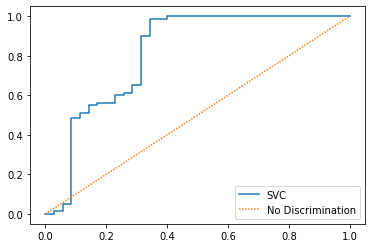

In [56]:
fpr, tpr, thresholds = roc_curve(y_test,svc.predict_proba(x_test)[:,1],pos_label=1)
precision, recall, thresholds = precision_recall_curve(y_test,svc.predict_proba(x_test)[:,1],pos_label=1)
plt.plot(fpr, tpr, label='SVC')
plt.plot([0,1], [0,1], label='No Discrimination', linestyle='-', dashes=(1, 1))
plt.legend()

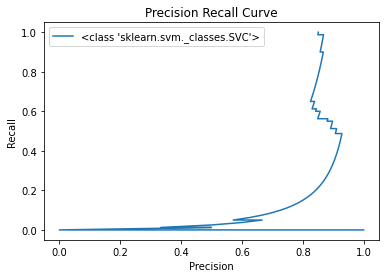

In [57]:
precision, recall, thresholds = precision_recall_curve(y_test,svc.predict_proba(x_test)[:,1],pos_label=1)
plt.plot(precision,recall, label=SVC)
plt.xlabel("Precision")
plt.ylabel("Recall")
plt.title("Precision Recall Curve")
plt.legend()

### Create a Function to find ROC, AUC, Prescision and recall curve for overall Module.

In [58]:
roc_dict = {} #ROC dict for TPR and FPR values
prc_dict = {} #precision recall curve

def modify_roc_dict(clf, y_test, x_test, name ,dict_modify): #modifies a dictionary in place and adds keys for ROC metrics
  fpr, tpr, thresholds = roc_curve(y_test,clf.predict_proba(x_test)[:,1],pos_label=1)
  clf_roc_dict = {'fpr':fpr, 'tpr': tpr, 'thresholds': thresholds}
  dict_modify[name] = clf_roc_dict
    
def modify_prc_dict(clf, y_test, x_test, name ,dict_modify): #modifies a dictionary in place and adds keys for precision recall metrics
  precision, recall, thresholds = precision_recall_curve(y_test,clf.predict_proba(x_test)[:,1],pos_label=1)
  clf_prc_dict = {'precision':precision, 'recall': recall, 'thresholds': thresholds}
  dict_modify[name] = clf_prc_dict

In [59]:
def fit_score_clf(clf, x_train, y_train, x_test, y_test, name='clf'): 
  clf.fit(x_train, y_train) #fit to train data
  y_pred = clf.predict(x_test) #make predictions
  clf_report = pd.DataFrame(classification_report(y_test, y_pred, output_dict=True)) #make dataframe from report
  clf_report['clf'] = name #add clf name as column
  return clf_report

In [60]:
lr_report = fit_score_clf(svc, x_train, y_train, x_test, y_test, name='SupportVector')
lr_report.head()

,0,1,accuracy,macro avg,weighted avg,clf
precision,1.000000,0.842105,0.869565,0.921053,0.890160,SupportVector
recall,0.571429,1.000000,0.869565,0.785714,0.869565,SupportVector
f1-score,0.727273,0.914286,0.869565,0.820779,0.857369,SupportVector
support,35.000000,80.000000,0.869565,115.000000,115.000000,SupportVector


In [61]:
lr_report = fit_score_clf(rf_clf, x_train, y_train, x_test, y_test, name='RandomForest')
lr_report.head()

,0,1,accuracy,macro avg,weighted avg,clf
precision,0.666667,0.860759,0.8,0.763713,0.801688,RandomForest
recall,0.685714,0.850000,0.8,0.767857,0.800000,RandomForest
f1-score,0.676056,0.855346,0.8,0.765701,0.800780,RandomForest
support,35.000000,80.000000,0.8,115.000000,115.000000,RandomForest


In [62]:
lr_report = fit_score_clf(ada_clf, x_train, y_train, x_test, y_test, name='AdaBoost')
lr_report.head()

,0,1,accuracy,macro avg,weighted avg,clf
precision,0.913043,0.847826,0.86087,0.880435,0.867675,AdaBoost
recall,0.600000,0.975000,0.86087,0.787500,0.860870,AdaBoost
f1-score,0.724138,0.906977,0.86087,0.815557,0.851330,AdaBoost
support,35.000000,80.000000,0.86087,115.000000,115.000000,AdaBoost


In [63]:
lr_report = fit_score_clf(gb_clf, x_train, y_train, x_test, y_test, name='GradientBoosting')
lr_report.head()

,0,1,accuracy,macro avg,weighted avg,clf
precision,0.657143,0.85,0.791304,0.753571,0.791304,GradientBoosting
recall,0.657143,0.85,0.791304,0.753571,0.791304,GradientBoosting
f1-score,0.657143,0.85,0.791304,0.753571,0.791304,GradientBoosting
support,35.000000,80.00,0.791304,115.000000,115.000000,GradientBoosting


In [64]:
#see keys we have
roc_dict.keys()

dict_keys([])

In [65]:
modify_roc_dict(clf=svc,y_test=y_test,x_test=x_test,name='SupportVector',dict_modify=roc_dict)
modify_roc_dict(clf=rf_clf,y_test=y_test,x_test=x_test,name='RandomForest',dict_modify=roc_dict)
modify_roc_dict(clf=ada_clf,y_test=y_test,x_test=x_test,name='AdaBoost',dict_modify=roc_dict)
modify_roc_dict(clf=gb_clf,y_test=y_test,x_test=x_test,name='GradientBoosting',dict_modify=roc_dict)

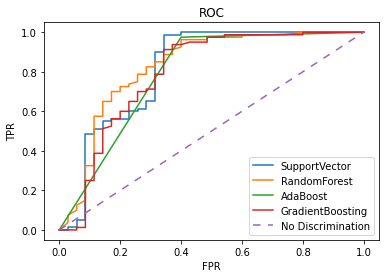

In [66]:
for key in roc_dict:
    clf = roc_dict[key]
    plt.plot(clf['fpr'], clf['tpr'], label=key)
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC")
plt.plot([0,1], [0,1], label='No Discrimination', linestyle='-', dashes=(5, 5))
plt.legend()
plt.show()

As per Above curve also its cleared that SVC is giving bet curve.

In [67]:
modify_prc_dict(clf=svc,y_test=y_test,x_test=x_test,name='SupportVector',dict_modify=prc_dict)
modify_prc_dict(clf=rf_clf,y_test=y_test,x_test=x_test,name='RandomForest',dict_modify=prc_dict)
modify_prc_dict(clf=ada_clf,y_test=y_test,x_test=x_test,name='AdaBoost',dict_modify=prc_dict)
modify_prc_dict(clf=gb_clf,y_test=y_test,x_test=x_test,name='GradientBoosting',dict_modify=prc_dict)

In [68]:
prc_dict.keys()



dict_keys(['SupportVector', 'RandomForest', 'AdaBoost', 'GradientBoosting'])

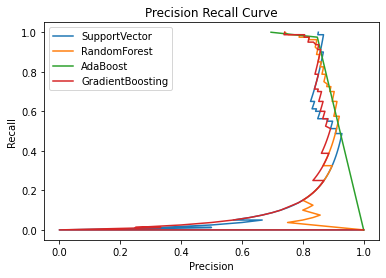

In [69]:
for key in prc_dict:
  clf = prc_dict[key]
  plt.plot(clf['precision'], clf['recall'], label=key)
plt.xlabel("Precision")
plt.ylabel("Recall")
plt.title("Precision Recall Curve")
plt.legend()
plt.show()

Aboveb curve also verified the SVC model is giving best output.
